# Importing Libraries and Dataset

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import math
from matplotlib import pyplot as plt
from datetime import date
import missingno as msno

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.neighbors import LocalOutlierFactor
from sklearn.model_selection import cross_validate, GridSearchCV
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, LabelEncoder

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, VotingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

pd.set_option('display.max_columns', None)
pd.set_option('display.width', 500)
pd.set_option('display.expand_frame_repr', False)

import warnings
warnings.filterwarnings('ignore')

/usr/local/lib/python3.11/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


In [ ]:
df_ = pd.read_csv('data.csv')
df = df_.copy()
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [ ]:
df = df.drop('Unnamed: 32', axis=1)
df.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,0.405172,1.216853,2.866059,40.337079,0.007041,0.025478,0.031894,0.011796,0.020542,0.003795,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,0.277313,0.551648,2.021855,45.491006,0.003003,0.017908,0.030186,0.006170,0.008266,0.002646,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,0.111500,0.360200,0.757000,6.802000,0.001713,0.002252,0.000000,0.000000,0.007882,0.000895,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,0.232400,0.833900,1.606000,17.850000,0.005169,0.013080,0.015090,0.007638,0.015160,0.002248,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,0.324200,1.108000,2.287000,24.530000,0.006380,0.020450,0.025890,0.010930,0.018730,0.003187,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,0.478900,1.474000,3.357000,45.190000,0.008146,0.032450,0.042050,0.014710,0.023480,0.004558,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,2.873000,4.885000,21.980000,542.200000,0.031130,0.135400,0.396000,0.052790,0.078950,0.029840,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [ ]:
df.isna().sum().sum()

0

## Duplicated Rows

In [22]:
def check_duplications(dataframe):
    if dataframe.duplicated().sum() > 0:
        if dataframe.duplicated().sum() == 1:
            print('There is {} duplicated value in data'.format(dataframe.duplicated().sum()))
        else:
            print('There are {} duplicated values in data'.format(dataframe.duplicated().sum()))
    else:
        print('There are no duplicated values in data')

check_duplications(df)

#df[df.duplicated()]
#df.drop_duplicates(keep='first',inplace=True)

There are no duplicated values in data


# Explorer Data Analysis

## Catching Numerical and Categorical Variables

In [ ]:
def grab_col_names(dataframe, cat_th=10, car_th=20):
    # cat_cols, cat_but_car
    cat_cols= [col for col in dataframe.columns if dataframe[col].dtypes == 'O']
    num_but_cat = [col for col in dataframe.columns if dataframe[col].dtypes != 'O' and
                   dataframe[col].nunique() < cat_th]
    cat_but_car = [col for col in dataframe.columns if dataframe[col].dtypes == 'O' and
                   dataframe[col].nunique() > car_th]
    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car]

    # num_cols
    num_cols = [col for col in dataframe.columns if dataframe[col].dtypes != 'O']
    num_cols = [col for col in num_cols if col not in num_but_cat ]

    print(f"Observations: {dataframe.shape[0]}")
    print(f"Variables: {dataframe.shape[1]}")
    print(f"cat_cols: {len(cat_cols)}")
    print(f"num_cols: {len(num_cols)}")
    print(f"cat_but_car: {len(cat_but_car)}")
    print(f"num_but_cat: {len(num_but_cat)}")
    return cat_cols, num_cols, cat_but_car

cat_cols, num_cols, cat_but_car = grab_col_names(df)

Observations: 569
Variables: 32
cat_cols: 1
num_cols: 31
cat_but_car: 0
num_but_cat: 0


In [ ]:
cat_cols # Our Target

['diagnosis']

In [ ]:
num_cols = [col for col in num_cols if col!='id']

## Numerical Variables Summary

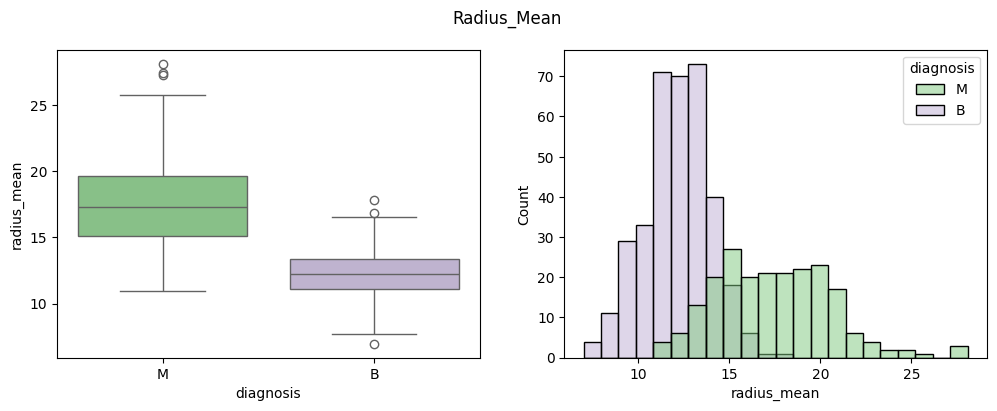

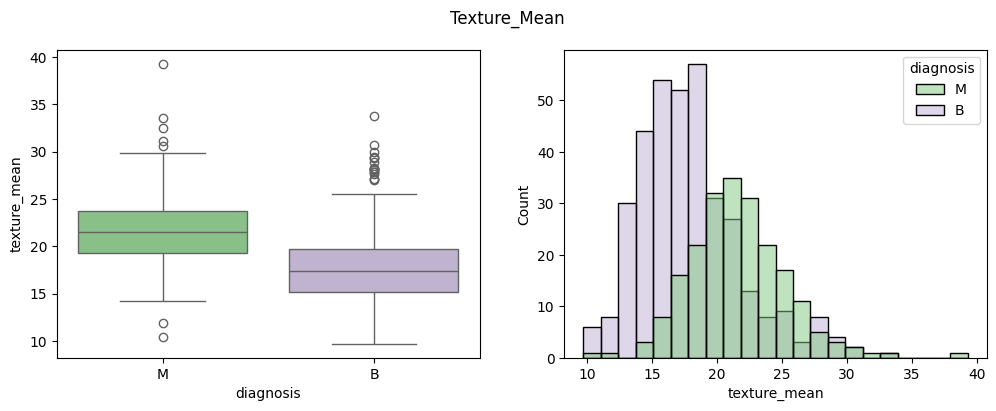

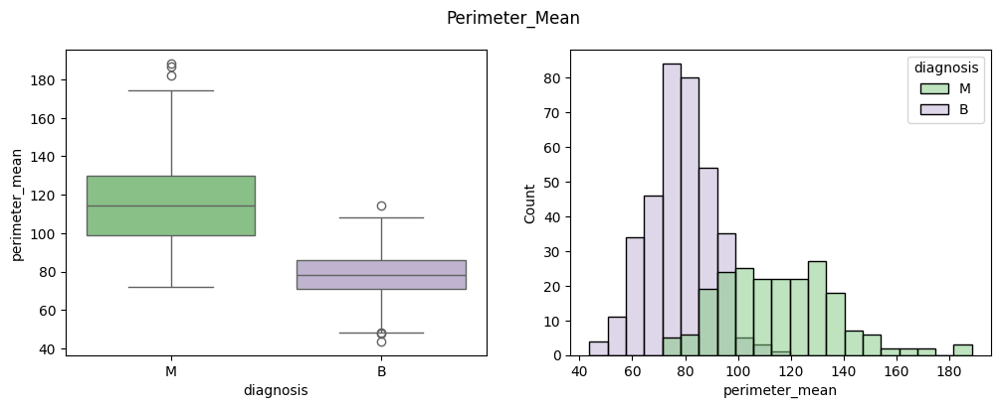

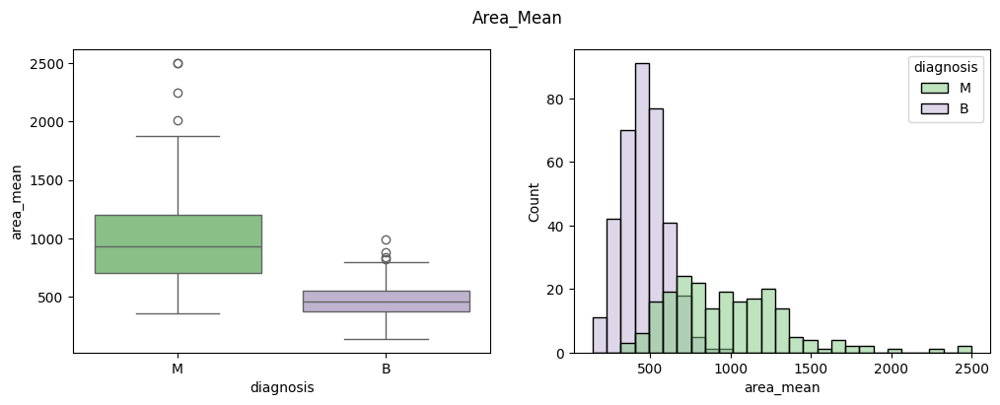

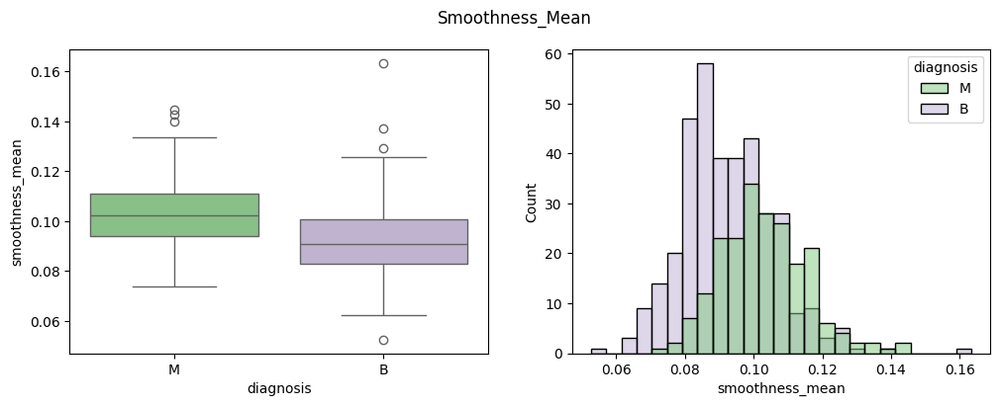

...

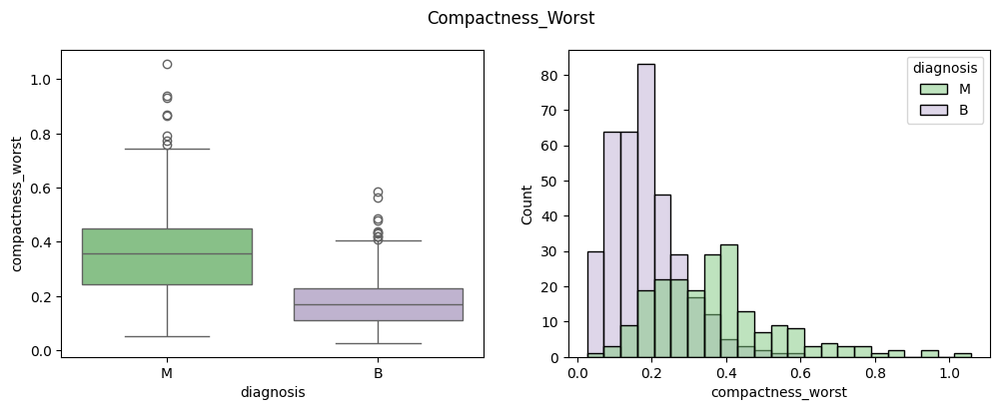

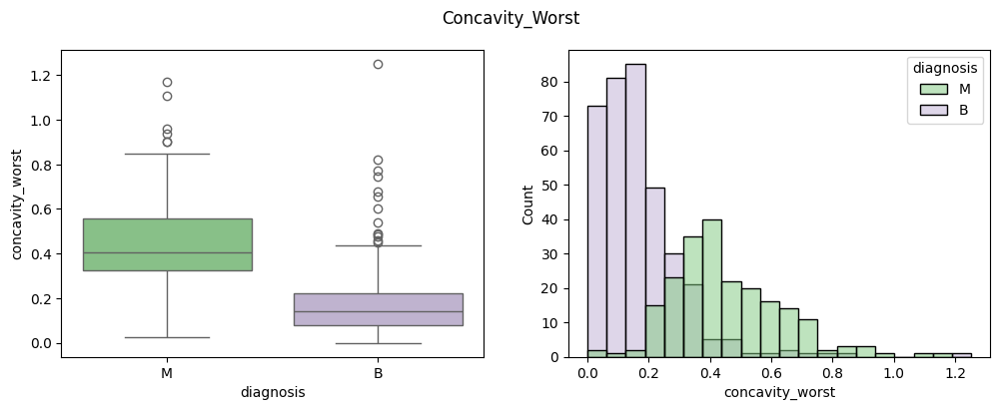

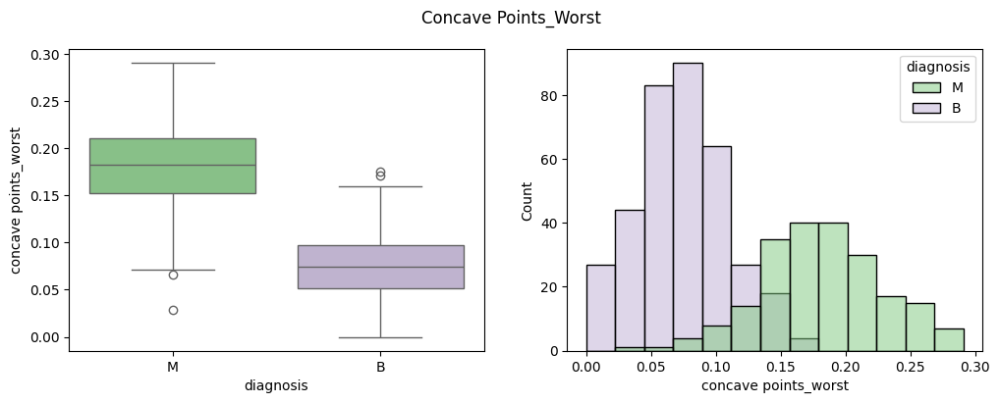

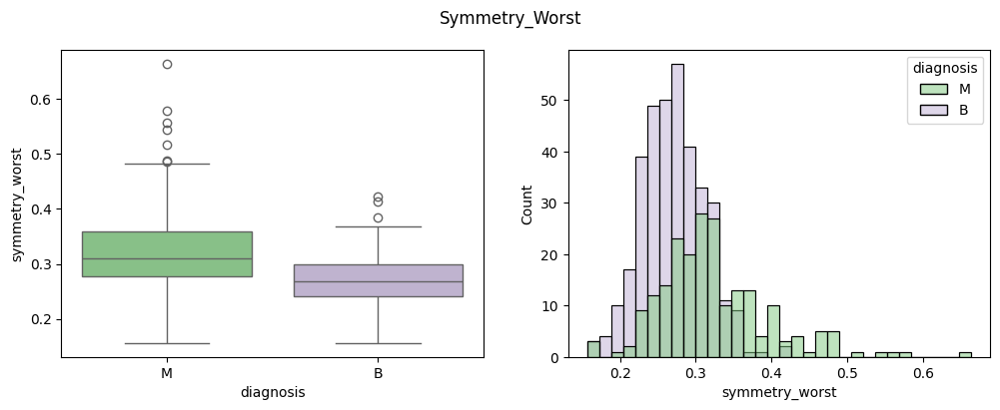

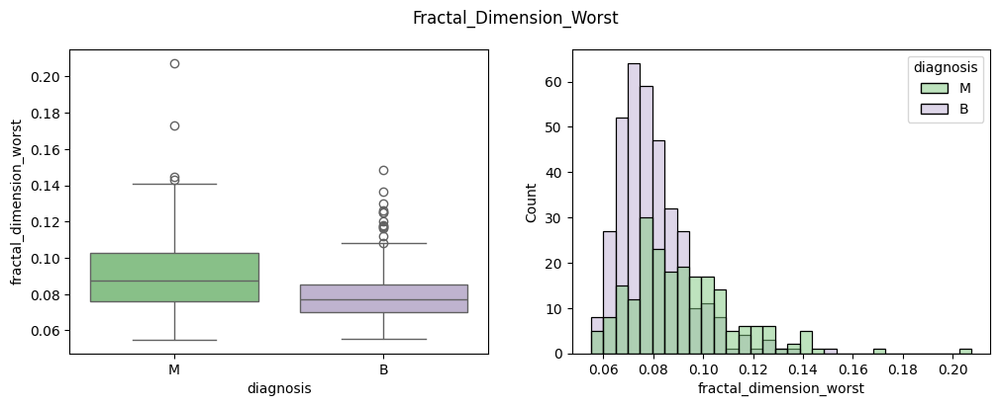

In [ ]:
for col in num_cols:
    fig, axes = plt.subplots(1, 2,figsize=(12,4))
    fig.suptitle(col.title(),size=12)
    sns.boxplot(ax=axes[0],y=col,x='diagnosis',data=df,palette='Accent')
    sns.histplot(ax=axes[1],x=col,hue='diagnosis',data=df,palette='Accent')
    plt.show()


## Pairwise Relationships



In [ ]:
num_cols.append('diagnosis')
plt.figure(figsize=(20,20))
sns.pairplot(df[num_cols],hue='diagnosis',palette='Accent')
plt.show()
num_cols.remove('diagnosis')

<Figure size 2000x2000 with 0 Axes>

# Encoding

In [13]:
# B:benign
# M:malignant
diagnosis_map = {'B':0, 'M':1}
df['diagnosis'] = df['diagnosis'].map(diagnosis_map)

## Pearson Correlation Map



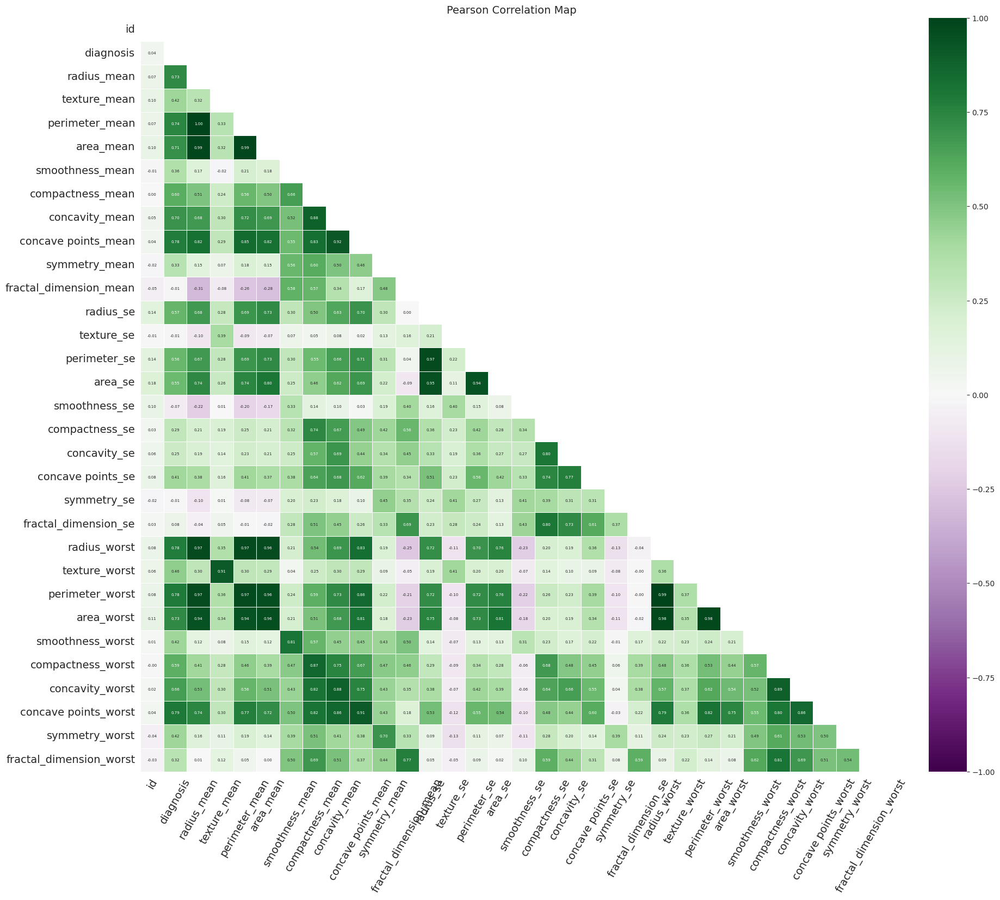

In [16]:
sns.set_style("white")
matrix = np.triu(df.corr(method="pearson"))
f,ax=plt.subplots(figsize = (30, 24))
sns.heatmap(df.corr(),annot= True,fmt = ".2f",ax=ax,
            vmin = -1, vmax = 1, mask = matrix, cmap = "PRGn",
            linewidth = 0.4,linecolor = "white",annot_kws={"size": 5})
plt.xticks(rotation=60,size=14)
plt.yticks(rotation=0,size=14)
plt.title('Pearson Correlation Map', size = 14)
plt.show()

## Outliers

In [20]:
def outlier_thresholds(dataframe, col_name,  q1=0.20, q3=0.80):
    Q1 = dataframe[col_name].quantile(q1)
    Q3 = dataframe[col_name].quantile(q3)
    IQR = Q3 - Q1
    low = Q1 - 1.5*IQR
    up = Q3 + 1.5*IQR
    return low, up

def grab_outliers(dataframe, col_name, index=False):
    low, up = outlier_thresholds(dataframe, col_name)
    if dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up) )].shape[0] > 10:
      print(dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up) )].head(10))
    else:
      print(dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up) )])
    if index:
      outlier_index = dataframe[((dataframe[col_name] < low) | (dataframe[col_name] > up) )].index
      return outlier_index

number =1
for col in num_cols:
    print(number, '.', col.upper(), end='\n\n')
    grab_outliers(df, col)
    number += 1

1 . RADIUS_MEAN

            id  diagnosis  radius_mean  texture_mean  perimeter_mean  area_mean  smoothness_mean  compactness_mean  concavity_mean  concave points_mean  symmetry_mean  fractal_dimension_mean  radius_se  texture_se  perimeter_se  area_se  smoothness_se  compactness_se  concavity_se  concave points_se  symmetry_se  fractal_dimension_se  radius_worst  texture_worst  perimeter_worst  area_worst  smoothness_worst  compactness_worst  concavity_worst  concave points_worst  symmetry_worst  fractal_dimension_worst
180     873592          1        27.22         21.87           182.1     2250.0           0.1094            0.1914          0.2871               0.1878         0.1800                 0.05770     0.8361      1.4810         5.820    128.7       0.004631         0.02537       0.03109            0.01241      0.01575              0.002747         33.12          32.85            220.8      3216.0            0.1472             0.4034           0.5340                0.2688   

In [21]:
def replace_with_thresholds(dataframe, col):
    low, up = outlier_thresholds(dataframe,col)
    dataframe.loc[dataframe[col] < low, col] = low
    dataframe.loc[dataframe[col] > up, col] = up

for col in num_cols:
  replace_with_thresholds(df,col)

# Scaling

In [24]:
X_scaled = StandardScaler().fit_transform(df[num_cols])
df[num_cols] = pd.DataFrame(X_scaled, columns=df[num_cols].columns)
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,1,1.111935,-2.098026,1.292838,1.060459,1.589814,3.139216,2.736123,2.546231,2.267883,2.398884,2.816780,-0.593424,2.787660,2.538221,-0.211633,1.494442,1.061453,0.731183,1.355261,1.353872,1.906056,-1.362375,2.337146,2.194471,1.321523,2.766982,2.176681,2.296076,2.836902,2.091098
1,842517,1,1.852603,-0.354817,1.714993,2.041567,-0.833719,-0.492515,-0.016644,0.552173,0.007060,-0.903186,0.654014,-0.931913,0.402812,1.285234,-0.662099,-0.740129,-0.544678,0.299298,-0.887861,-0.053609,1.824572,-0.369478,1.558697,2.074280,-0.376431,-0.439038,-0.143334,1.087084,-0.240660,0.317961
2,84300903,1,1.599972,0.466071,1.593780,1.670255,0.956210,1.088571,1.410095,2.048559,0.964278,-0.405778,1.540742,-0.827246,1.158381,1.976143,-0.307174,0.936421,0.356913,1.554737,0.308749,0.495949,1.527887,-0.023271,1.368611,1.603057,0.534450,1.153263,0.886687,1.955000,1.294385,0.232509
3,84348301,1,-0.774186,0.260849,-0.597247,-0.795797,3.320775,3.139216,1.978208,1.460165,2.930859,3.158330,0.443849,-0.098329,0.432730,-0.337276,0.828584,2.970589,1.193126,1.220769,3.073042,2.833711,-0.281472,0.135135,-0.249537,-0.574298,3.276823,3.192399,2.053355,2.175786,2.836902,3.067510
4,84358402,1,1.772220,-1.163911,1.806948,1.954022,0.286607,0.561283,1.417842,1.436837,-0.004114,-0.579571,1.591638,-0.838305,1.701347,1.990343,1.741795,-0.023650,1.205470,1.252242,-0.377808,0.783687,1.312686,-1.470156,1.359559,1.347414,0.224927,-0.315884,0.638061,0.729259,-0.927251,-0.408384


# Model

In [26]:
y = df['diagnosis']
X = df.drop(['id', 'diagnosis'], axis=1)

# Base Model

In [36]:
models = [('LR', LogisticRegression(random_state=123)),
          ('RF', RandomForestClassifier(random_state=123)),
          ("LightGBM", LGBMClassifier(random_state=123, verbosity=-1)),
          ]

for name, model in models:
    cv_results = cross_validate(
        model, X, y, cv=4, scoring=['accuracy', 'f1', 'roc_auc', 'precision', 'recall']
    )
    print(f"###  {name}  ###")
    print(f"Accuracy: {round(cv_results['test_accuracy'].mean(), 4)}")
    print(f"F1 Score: {round(cv_results['test_f1'].mean(), 4)}")
    print(f"Roc_Auc: {round(cv_results['test_roc_auc'].mean(), 4)}")
    print(f"Precision: {round(cv_results['test_precision'].mean(), 4)}")
    print(f"Recall: {round(cv_results['test_recall'].mean(), 4)}", end='\n\n')

###  LR  ###
Accuracy: 0.9771
F1 Score: 0.9693
Roc_Auc: 0.9963
Precision: 0.9727
Recall: 0.967

###  RF  ###
Accuracy: 0.9614
F1 Score: 0.9473
Roc_Auc: 0.9912
Precision: 0.9575
Recall: 0.9387

###  LightGBM  ###
Accuracy: 0.9719
F1 Score: 0.9625
Roc_Auc: 0.9932
Precision: 0.9631
Recall: 0.9623



In [40]:
lr_params = {"penalty": ["l1", "l2", "elasticnet", "none"],
    "C": [0.01, 0.1, 1, 10, 100],
    "solver": ["lbfgs", "liblinear", "saga"],
    "max_iter": [100, 200, 500],
    "l1_ratio": [0.1, 0.5, 0.9]  # Only used if penalty is "elasticnet"
                 }


rf_params = {"max_depth": [8,  15,  None],
             "max_features": [  8, "auto"],
             "min_samples_split": [15, 20],
             "n_estimators": [ 200, 300]}



lightgbm_params = {"learning_rate": [0.01, 0.1],
                  "n_estimators": [300, 500]}


classifiers = [('LR', LogisticRegression(), lr_params),
               ("RF", RandomForestClassifier(), rf_params),
               ('LightGBM', LGBMClassifier(), lightgbm_params)
             ]



def hyperparameter_optimization(X, y, cv=4, scoring='accuracy'):
    print("Hyperparameter Optimization....")
    best_models = {}
    for name, classifier, params in classifiers:
        print(f"########## {name} ##########")
        cv_results = cross_validate(classifier, X, y, cv=cv, scoring=scoring)
        print(f"{scoring} (Before): {round(cv_results['test_score'].mean(), 4)}")

        gs_best = GridSearchCV(classifier, params, cv=cv, n_jobs=-1, verbose=False).fit(X, y)
        final_model = classifier.set_params(**gs_best.best_params_)

        cv_results = cross_validate(final_model, X, y, cv=cv, scoring=scoring)
        print(f"{scoring} (After): {round(cv_results['test_score'].mean(), 4)}")
        print(f"{name} best params: {gs_best.best_params_}", end="\n\n")
        best_models[name] = final_model
    return best_models

best_models = hyperparameter_optimization(X, y)

Hyperparameter Optimization....
########## LR ##########
accuracy (Before): 0.9771
accuracy (After): 0.9789
LR best params: {'C': 0.1, 'l1_ratio': 0.1, 'max_iter': 100, 'penalty': 'l2', 'solver': 'liblinear'}

########## RF ##########
accuracy (Before): 0.9649
accuracy (After): 0.9579
RF best params: {'max_depth': None, 'max_features': 8, 'min_samples_split': 15, 'n_estimators': 200}

########## LightGBM ##########
accuracy (Before): 0.9719
accuracy (After): 0.9754
LightGBM best params: {'learning_rate': 0.1, 'n_estimators': 500}

